# Chatgpt Ising

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import convolve
from matplotlib.animation import FuncAnimation


In [10]:

class IsingModel:
    def __init__(self, L, T_initial, T_final, cooling_steps, J=1, B=0):
        self.L = L                     # Lattice size (LxL)
        self.T_initial = T_initial     # Initial temperature
        self.T_final = T_final         # Final temperature
        self.cooling_steps = cooling_steps  # Number of steps to cool
        self.J = J                     # Interaction energy
        self.B = B                     # External magnetic field
        self.lattice = np.random.choice([-1, 1], size=(L, L))  # Random initial state
        self.frames = []               # Store frames for animation

    def energy(self):
        """Calculate the total energy of the lattice using convolution."""
        kernel = np.array([[0, 1, 0],
                           [1, 0, 1],
                           [0, 1, 0]])

        neighbors = convolve(self.lattice, kernel, mode='wrap')
        total_energy = -self.J * np.sum(self.lattice * neighbors)
        return total_energy / 2  # Each pair counted twice

    def magnetization(self):
        """Calculate the total magnetization of the lattice."""
        return np.sum(self.lattice)

    def metropolis_step(self, T):
        """Perform one Metropolis step updating a checkerboard pattern."""
        kernel = np.array([[0, 1, 0],
                           [1, 0, 1],
                           [0, 1, 0]])
        
        # Update spins in sub-lattice 1 (black squares)
        for _ in range(self.L**2 // 2):  # Half the number of spins
            i, j = np.random.randint(0, self.L, size=2)
            if (i + j) % 2 == 0:  # Only update sub-lattice 1
                neighbors = convolve(self.lattice, kernel, mode='wrap')
                neighbor_sum = neighbors[i, j]
                delta_E = 2 * self.J * self.lattice[i, j] * neighbor_sum + 2 * self.B * self.lattice[i, j]

                if delta_E <= 0 or np.random.rand() < np.exp(-delta_E / T):
                    self.lattice[i, j] *= -1  # Flip the spin

        # Update spins in sub-lattice 2 (white squares)
        for _ in range(self.L**2 // 2):  # Half the number of spins
            i, j = np.random.randint(0, self.L, size=2)
            if (i + j) % 2 == 1:  # Only update sub-lattice 2
                neighbors = convolve(self.lattice, kernel, mode='wrap')
                neighbor_sum = neighbors[i, j]
                delta_E = 2 * self.J * self.lattice[i, j] * neighbor_sum + 2 * self.B * self.lattice[i, j]

                if delta_E <= 0 or np.random.rand() < np.exp(-delta_E / T):
                    self.lattice[i, j] *= -1  # Flip the spin

    def simulate(self, n_steps):
        """Run the simulation for a specified number of steps, with decreasing temperature."""
        for step in range(n_steps):
            T = self.T_initial - (self.T_initial - self.T_final) * (step / self.cooling_steps) if step < self.cooling_steps else self.T_final
            self.metropolis_step(T)
            # Store the current lattice state for animation
            self.frames.append(self.lattice.copy())
            if step % 100 == 0:  # Output progress
                print(f"Step {step}/{n_steps}: Energy = {self.energy()}, Magnetization = {self.magnetization()}, Temperature = {T:.2f}")

    def animate(self):
        """Create an animation of the Ising model simulation."""
        fig, ax = plt.subplots()
        img = ax.imshow(self.frames[0], cmap='coolwarm', interpolation='nearest', vmin=-1, vmax=1)
        plt.colorbar(img, label='Spin')
        ax.set_title(f'2D Ising Model Animation (T={self.T_initial})')
        ax.axis('off')

        def update(frame):
            img.set_array(self.frames[frame])
            return img,

        return FuncAnimation(fig, update, frames=len(self.frames), interval=50, blit=True)
        

# Parameters
L = 50                   # Size of the lattice (20x20)
T_initial = 5.0         # Initial temperature
T_final = 1.0           # Final temperature
cooling_steps = 10000   # Number of steps to cool
n_steps = 1000         # Total number of simulation steps

# Create Ising model instance
ising_model = IsingModel(L, T_initial, T_final, cooling_steps, B=0.5)

# Run simulation
ising_model.simulate(n_steps)

# Animate the final state of the lattice
ani = ising_model.animate()

%matplotlib notebook

from IPython.display import HTML
import ipywidgets as widgets

HTML(ani.to_jshtml())


Step 0/1000: Energy = -692.0, Magnetization = 88, Temperature = 5.00
Step 100/1000: Energy = -1172.0, Magnetization = 684, Temperature = 4.96
Step 200/1000: Energy = -1336.0, Magnetization = 730, Temperature = 4.92
Step 300/1000: Energy = -1364.0, Magnetization = 766, Temperature = 4.88
Step 400/1000: Energy = -1388.0, Magnetization = 632, Temperature = 4.84
Step 500/1000: Energy = -1500.0, Magnetization = 906, Temperature = 4.80
Step 600/1000: Energy = -1296.0, Magnetization = 620, Temperature = 4.76
Step 700/1000: Energy = -1604.0, Magnetization = 880, Temperature = 4.72
Step 800/1000: Energy = -1580.0, Magnetization = 854, Temperature = 4.68
Step 900/1000: Energy = -1240.0, Magnetization = 636, Temperature = 4.64


<IPython.core.display.Javascript object>

Animation size has reached 20985090 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


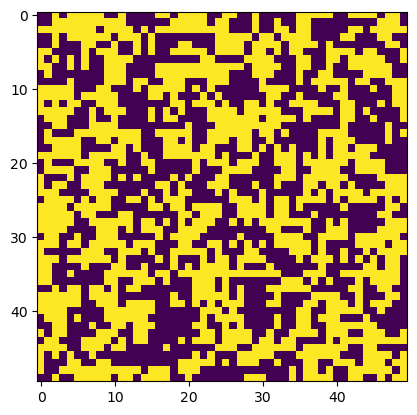

In [28]:
plt.imshow(ising_model.lattice)

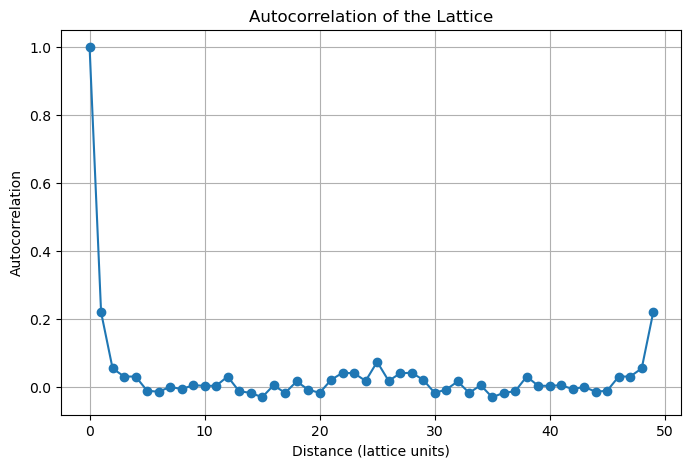

In [27]:
%matplotlib inline

# Calculate and plot autocorrelation
autocorr = ising_model.autocorrelation()

plt.figure(figsize=(8, 5))
plt.plot(autocorr, marker='o')
plt.title('Autocorrelation of the Lattice')
plt.xlabel('Distance (lattice units)')
plt.ylabel('Autocorrelation')
plt.grid()
plt.show()

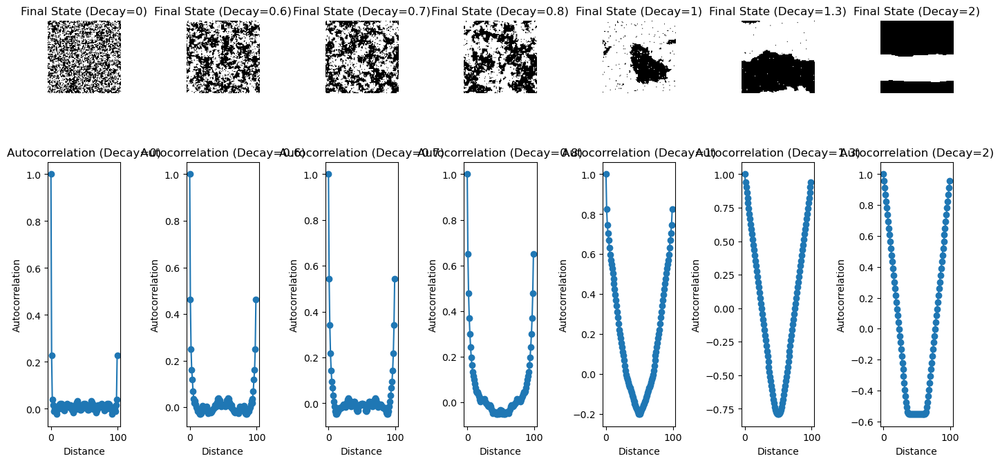

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import convolve
from matplotlib.animation import FuncAnimation

class IsingModel:
    def __init__(self, L, T_initial, T_final, cooling_steps, J=1, B=0):
        self.L = L                     # Lattice size (LxL)
        self.T_initial = T_initial     # Initial temperature
        self.T_final = T_final         # Final temperature
        self.cooling_steps = cooling_steps  # Number of steps to cool
        self.J = J                     # Interaction energy
        self.B = B                     # External magnetic field
        self.lattice = np.random.choice([-1, 1], size=(L, L))  # Random initial state
        self.frames = []               # Store frames for animation

    def energy(self):
        """Calculate the total energy of the lattice using convolution."""
        kernel = np.array([[0, 1, 0],
                           [1, 0, 1],
                           [0, 1, 0]])

        neighbors = convolve(self.lattice, kernel, mode='wrap')
        total_energy = -self.J * np.sum(self.lattice * neighbors)
        return total_energy / 2  # Each pair counted twice

    def magnetization(self):
        """Calculate the total magnetization of the lattice."""
        return np.sum(self.lattice)

    def metropolis_step(self, T):
        """Perform one Metropolis step updating entire checkerboard sub-lattices."""
        kernel = np.array([[0, 1, 0],
                           [1, 0, 1],
                           [0, 1, 0]])
        
        # Create masks for the two sublattices
        mask1 = (np.indices((self.L, self.L)).sum(axis=0) % 2 == 0)  # Sublattice 1
        mask2 = (np.indices((self.L, self.L)).sum(axis=0) % 2 == 1)  # Sublattice 2
        
        # Update spins in sub-lattice 1
        neighbors = convolve(self.lattice, kernel, mode='wrap')
        delta_E1 = 2 * self.J * self.lattice[mask1] * neighbors[mask1] + 2 * self.B * self.lattice[mask1]
        
        # Apply Metropolis criterion for sub-lattice 1
        flips1 = (delta_E1 <= 0) | (np.random.rand(np.sum(mask1)) < np.exp(-delta_E1 / T))
        self.lattice[mask1] *= np.where(flips1, -1, 1)  # Flip spins where the condition is met
        
        # Update spins in sub-lattice 2
        neighbors = convolve(self.lattice, kernel, mode='wrap')
        delta_E2 = 2 * self.J * self.lattice[mask2] * neighbors[mask2] + 2 * self.B * self.lattice[mask2]
        
        # Apply Metropolis criterion for sub-lattice 2
        flips2 = (delta_E2 <= 0) | (np.random.rand(np.sum(mask2)) < np.exp(-delta_E2 / T))
        self.lattice[mask2] *= np.where(flips2, -1, 1)  # Flip spins where the condition is met


    def autocorrelation(self):
        """Calculate the autocorrelation of the lattice."""
        N = self.L * self.L  # Total number of spins
        avg_spin = np.mean(self.lattice)
        autocorr = np.zeros(self.L)  # Store autocorrelation values

        for d in range(self.L):
            # Shift the lattice by d positions (periodic boundary conditions)
            shifted_lattice = np.roll(self.lattice, shift=d, axis=0)
            # Calculate the autocorrelation at distance d
            autocorr[d] = np.mean((self.lattice - avg_spin) * (shifted_lattice - avg_spin)) / np.var(self.lattice)

        return autocorr

    def simulate(self, n_steps, decay_rate):
        """Run the simulation for a specified number of steps, with exponential decay of temperature."""
        for step in range(n_steps):
            # Exponential decay of temperature
            T = self.T_final + (self.T_initial - self.T_final) * np.exp(-decay_rate * step / n_steps)
            self.metropolis_step(T)
            # Store the current lattice state for animation
            self.frames.append(self.lattice.copy())

# Parameters
L = 100                    # Size of the lattice (20x20)
T_initial = 5.0          # Initial temperature
T_final = 0.0            # Final temperature (0)
n_steps = 300           # Total number of simulation steps

# Different exponential decay rates to simulate
decay_rates = [0, 0.6, 0.7, 0.8, 1, 1.3, 2]  # Different rates


# Set up the figure
fig, axes = plt.subplots(2, len(decay_rates), figsize=(14, 8))

# Initialize a plot for autocorrelations
for idx, decay_rate in enumerate(decay_rates):
    # Create Ising model instance
    ising_model = IsingModel(L, T_initial, T_final, cooling_steps=n_steps)

    # Run simulation
    ising_model.simulate(n_steps, decay_rate)

    # Plot the final lattice configuration
    axes[0, idx].imshow(ising_model.lattice, cmap='gray')
    axes[0, idx].set_title(f'Final State (Decay={decay_rate})')
    axes[0, idx].axis('off')

    # Calculate and plot autocorrelation
    autocorr = ising_model.autocorrelation()
    axes[1, idx].plot(autocorr, marker='o')
    axes[1, idx].set_title(f'Autocorrelation (Decay={decay_rate})')
    axes[1, idx].set_xlabel('Distance')
    axes[1, idx].set_ylabel('Autocorrelation')

plt.tight_layout()
plt.show()

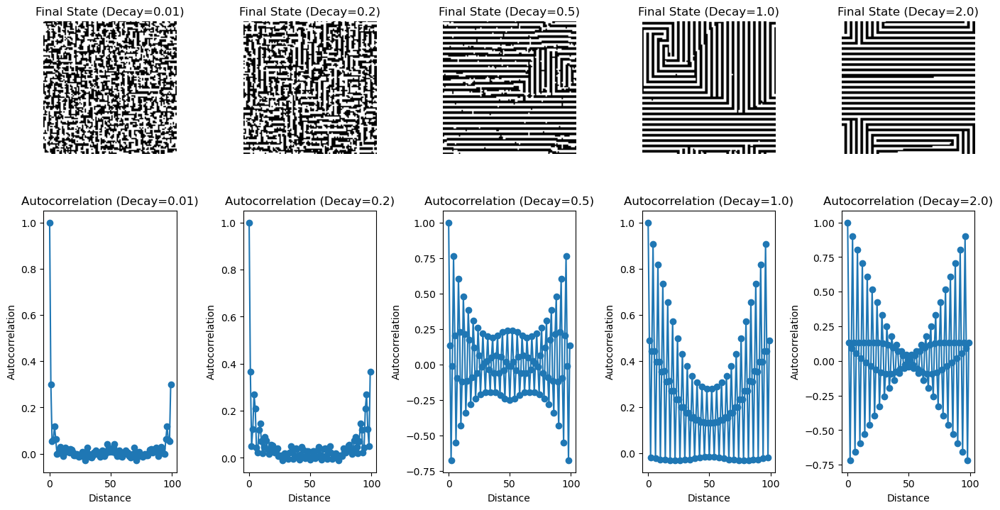

In [28]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import convolve

class GeneralizedIsingModel:
    def __init__(self, L, T_initial, T_final, cooling_steps, kernel, J=1, B=0):
        """
        Initialize the generalized Ising model.
        
        L: Lattice size (L x L)
        T_initial: Initial temperature
        T_final: Final temperature
        cooling_steps: Number of steps to cool the system
        kernel: Interaction kernel (N x N) that defines the neighborhood
        J: Coupling constant (default 1)
        B: External magnetic field (default 0)
        """
        self.L = L                     # Lattice size (LxL)
        self.T_initial = T_initial     # Initial temperature
        self.T_final = T_final         # Final temperature
        self.cooling_steps = cooling_steps  # Number of steps to cool
        self.J = J                     # Interaction energy
        self.B = B                     # External magnetic field
        self.kernel = kernel            # General interaction kernel
        self.kernel_size = kernel.shape[0]  # Kernel size (assumed square)
        self.lattice = np.random.choice([-1, 1], size=(L, L))  # Random initial state
        self.frames = []               # Store frames for animation

    def energy(self):
        """Calculate the total energy of the lattice using convolution."""
        neighbors = convolve(self.lattice, self.kernel, mode='wrap')
        total_energy = -self.J * np.sum(self.lattice * neighbors)
        return total_energy / 2  # Each pair counted twice

    def magnetization(self):
        """Calculate the total magnetization of the lattice."""
        return np.sum(self.lattice)

    def metropolis_step(self, T):
        """Perform one Metropolis step updating multiple sublattices."""
        # Determine the number of sublattices based on kernel size
        N = self.kernel_size
        sublattices = N*N #N//2+1
        
        # Create masks for the N x N sublattices
        sublattice_masks = [(np.indices((self.L, self.L)).sum(axis=0) % N == i) for i in range(sublattices)]
        
        for mask in sublattice_masks:
            # Calculate the neighbor sum for spins in the current sublattice
            neighbors = convolve(self.lattice, self.kernel, mode='wrap')
            delta_E = 2 * self.J * self.lattice[mask] * neighbors[mask] + 2 * self.B * self.lattice[mask]

            # Apply the Metropolis criterion
            flips = (delta_E <= 0) | (np.random.rand(np.sum(mask)) < np.exp(-delta_E / T))
            self.lattice[mask] *= np.where(flips, -1, 1)  # Flip spins where the condition is met

    def autocorrelation(self):
        """Calculate the autocorrelation of the lattice."""
        N = self.L * self.L  # Total number of spins
        avg_spin = np.mean(self.lattice)
        autocorr = np.zeros(self.L)  # Store autocorrelation values

        for d in range(self.L):
            # Shift the lattice by d positions (periodic boundary conditions)
            shifted_lattice = np.roll(self.lattice, shift=d, axis=0)
            # Calculate the autocorrelation at distance d
            autocorr[d] = np.mean((self.lattice - avg_spin) * (shifted_lattice - avg_spin)) / np.var(self.lattice)

        return autocorr

    def simulate(self, n_steps, decay_rate):
        """Run the simulation for a specified number of steps, with exponential decay of temperature."""
        for step in range(n_steps):
            # Exponential decay of temperature
            T = self.T_final + (self.T_initial - self.T_final) * np.exp(-decay_rate * step / n_steps)
            self.metropolis_step(T)
            # Store the current lattice state for animation
            self.frames.append(self.lattice.copy())

# Example of usage
L = 100  # Size of the lattice (20x20)
T_initial = 20.  # Initial temperature
T_final = 0.0  # Final temperature (0)
n_steps = 400  # Total number of simulation steps

# Example kernel: A 3x3 interaction kernel (for simplicity)
'''kernel = np.array([[0, 0, 1, 0, 0],
                   [0, 1, 2, 1, 0],
                   [1, 2, 0, 2, 1],
                   [0, 1, 2, 1, 0],
                   [0, 0, 1, 0, 0]])'''

kernel = np.array([[-2, -2, 1,  -2, -2],
                   [-2,  1, 6,  1, -2],
                   [1,   6, 0,  6, 1],
                   [-2,  1, 6,  1, -2],
                   [-2, -2, 1,  -2, -2]])

# Different exponential decay rates to simulate
decay_rates = [0.01, 0.2, 0.5, 1.0, 2.0]  # Different rates

# Set up the figure
fig, axes = plt.subplots(2, len(decay_rates), figsize=(14, 8))

# Initialize a plot for autocorrelations
for idx, decay_rate in enumerate(decay_rates):
    # Create Ising model instance with the custom kernel
    ising_model = GeneralizedIsingModel(L, T_initial, T_final, cooling_steps=n_steps, kernel=kernel)

    # Run simulation
    ising_model.simulate(n_steps, decay_rate)

    # Plot the final lattice configuration
    axes[0, idx].imshow(ising_model.lattice, cmap='gray')
    axes[0, idx].set_title(f'Final State (Decay={decay_rate})')
    axes[0, idx].axis('off')

    # Calculate and plot autocorrelation
    autocorr = ising_model.autocorrelation()
    axes[1, idx].plot(autocorr, marker='o')
    axes[1, idx].set_title(f'Autocorrelation (Decay={decay_rate})')
    axes[1, idx].set_xlabel('Distance')
    axes[1, idx].set_ylabel('Autocorrelation')

plt.tight_layout()
plt.show()

In [34]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import convolve
from scipy.optimize import curve_fit

class GeneralizedIsingModel:
    def __init__(self, L, T_initial, T_final, cooling_steps, kernel, J=1, B=0):
        self.L = L
        self.T_initial = T_initial
        self.T_final = T_final
        self.cooling_steps = cooling_steps
        self.J = J
        self.B = B
        self.kernel = kernel
        self.kernel_size = kernel.shape[0]
        self.lattice = np.random.choice([-1, 1], size=(L, L))
        self.frames = []

    def energy(self):
        neighbors = convolve(self.lattice, self.kernel, mode='wrap')
        total_energy = -self.J * np.sum(self.lattice * neighbors)
        return total_energy / 2

    def magnetization(self):
        return np.sum(self.lattice)

    def metropolis_step(self, T):
        N = self.kernel_size
        num_sublattices = (N // 2) + 1
        sublattice_masks = [(np.indices((self.L, self.L)).sum(axis=0) % num_sublattices == i) for i in range(num_sublattices)]
        
        for mask in sublattice_masks:
            neighbors = convolve(self.lattice, self.kernel, mode='wrap')
            delta_E = 2 * self.J * self.lattice[mask] * neighbors[mask] + 2 * self.B * self.lattice[mask]
            flips = (delta_E <= 0) | (np.random.rand(np.sum(mask)) < np.exp(-delta_E / T))
            self.lattice[mask] *= np.where(flips, -1, 1)

    def simulate_near_Tc(self, Tc, temp_range, n_steps):
        """Simulate and measure magnetization for temperatures near Tc."""
        magnetizations = []
        temperatures = np.linspace(Tc - temp_range, Tc, n_steps)

        for T in temperatures:
            self.lattice = np.random.choice([-1, 1], size=(self.L, self.L))  # Random initial state
            for _ in range(5000):  # Thermalize the system
                self.metropolis_step(T)

            # Measure magnetization
            M = np.abs(self.magnetization()) / (self.L**2)  # Normalize magnetization
            magnetizations.append(M)
        
        return temperatures, magnetizations

    def fit_power_law(self, temperatures, magnetizations, Tc):
        """Fit M(T) to the form M(T) = A * (Tc - T)^beta."""
        def magnetization_model(T, A, beta):
            return A * (Tc - T) ** beta
        
        # Fit the power-law curve
        popt, _ = curve_fit(magnetization_model, temperatures, magnetizations, p0=(1, 0.125))
        A, beta = popt
        return beta, A

    def plot_critical_exponent(self, Tc, temp_range, n_steps):
        """Simulate near Tc, fit and plot the critical exponent."""
        temperatures, magnetizations = self.simulate_near_Tc(Tc, temp_range, n_steps)
        beta, A = self.fit_power_law(temperatures, magnetizations, Tc)

        # Plot the results
        plt.figure(figsize=(8, 6))
        plt.scatter(temperatures, magnetizations, label='Simulated Magnetization')
        plt.plot(temperatures, A * (Tc - temperatures) ** beta, label=f'Fit: β = {beta:.3f}', color='red')
        plt.xlabel('Temperature')
        plt.ylabel('Magnetization')
        plt.title(f'Critical Exponent β near Tc = {Tc}')
        plt.legend()
        plt.grid(True)
        plt.show()

        return beta
    
    def simulate_percolation(self, p):
        """Simulate site percolation on the lattice and visualize it."""
        # Generate a random percolation grid (0 = unoccupied, 1 = occupied)
        percolation_grid = np.random.rand(self.L, self.L) < p
        
        # Identify clusters in the percolation grid using a nearest-neighbor connectivity
        structure = np.array([[0, 1, 0],  # This structure defines nearest-neighbor connectivity
                              [1, 1, 1],
                              [0, 1, 0]])
        labeled_grid, num_features = label(percolation_grid, structure=structure)
        
        # Check if there's a percolating cluster (one that touches both the left and right sides)
        percolating_cluster = False
        for label_num in range(1, num_features + 1):
            cluster = (labeled_grid == label_num)
            if cluster[:, 0].any() and cluster[:, -1].any():  # Check for percolation horizontally
                percolating_cluster = True
                break

        # Plot the percolation grid
        plt.figure(figsize=(6, 6))
        plt.imshow(percolation_grid, cmap='Greys', interpolation='none')
        plt.title(f"Percolation grid (p = {p:.2f}) {'- Percolating!' if percolating_cluster else ''}")
        plt.xlabel("X-axis")
        plt.ylabel("Y-axis")
        plt.grid(False)
        plt.show()

        return percolating_cluster


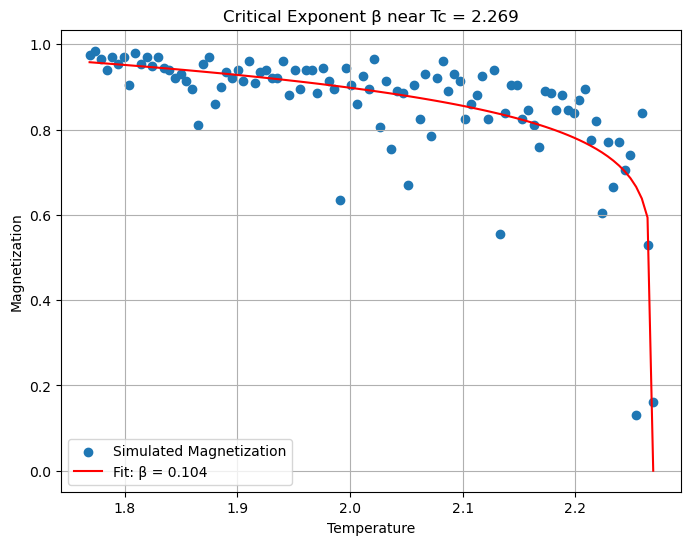

Estimated critical exponent β = 0.10407298134545248


In [32]:
# Parameters
L = 20  # Lattice size
Tc = 2.269  # Known critical temperature for 2D Ising model
temp_range = 0.5  # Temperature range to simulate near Tc
n_steps = 100  # Number of temperature points

# Kernel: Nearest-neighbor interactions
kernel = np.array([[0, 1, 0],
                   [1, 0, 1],
                   [0, 1, 0]])

# Initialize the Ising model
ising_model = GeneralizedIsingModel(L, T_initial=Tc, T_final=Tc-temp_range, cooling_steps=5000, kernel=kernel)

# Estimate the critical exponent β
beta = ising_model.plot_critical_exponent(Tc, temp_range, n_steps)
print(f"Estimated critical exponent β = {beta}")


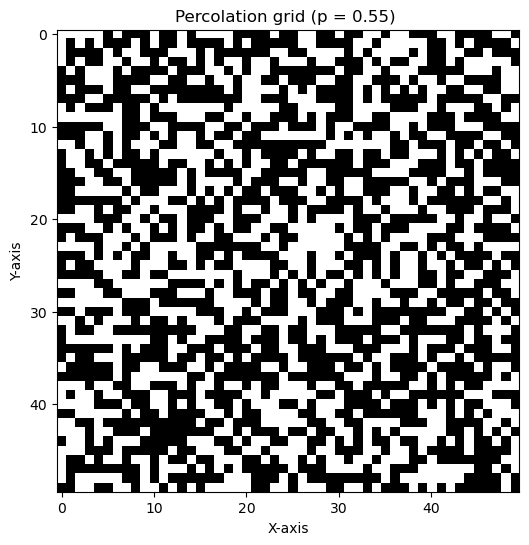

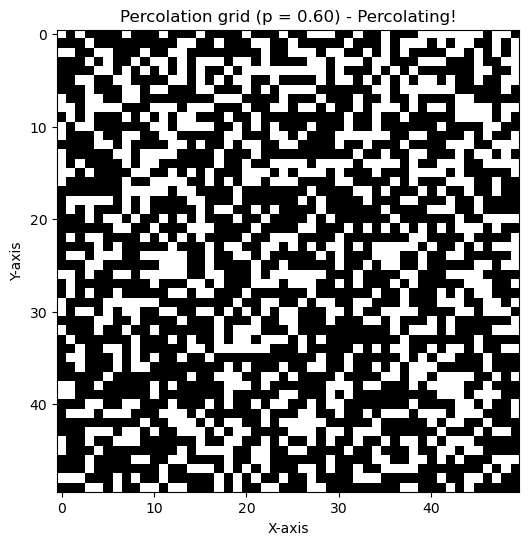

In [36]:
from scipy.ndimage import label

# Example usage:
L = 50  # Lattice size
kernel = np.array([[0, 1, 0], [1, 0, 1], [0, 1, 0]])  # Nearest neighbor kernel

ising_model = GeneralizedIsingModel(L, T_initial=2.5, T_final=1.0, cooling_steps=1000, kernel=kernel)

# Simulate percolation with probability p = 0.55 (just below percolation threshold)
percolating_cluster = ising_model.simulate_percolation(p=0.55)

# Simulate percolation with probability p = 0.60 (above percolation threshold)
percolating_cluster = ising_model.simulate_percolation(p=0.60)

/tmp/ipykernel_19050/1579860611.py:50: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('coolwarm', 3)


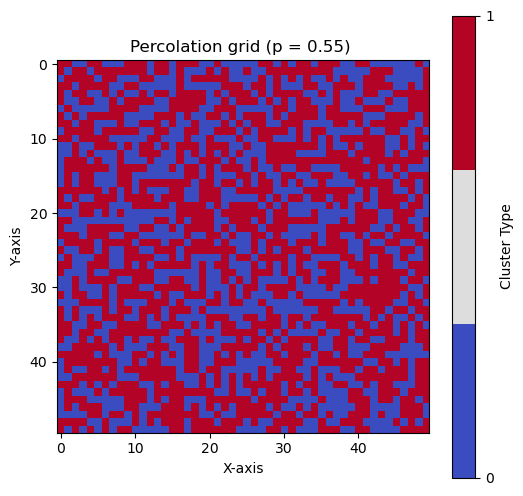

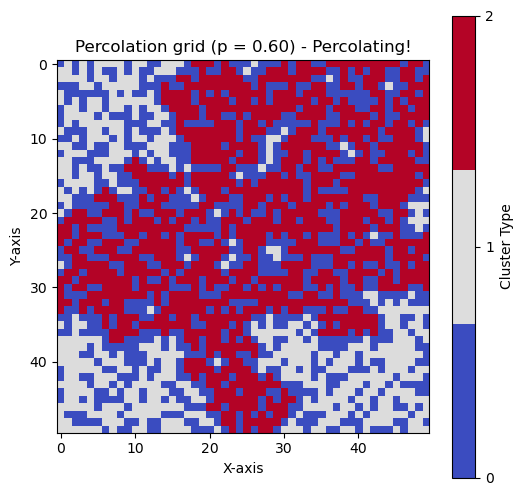

In [37]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import label

class GeneralizedIsingModel:
    def __init__(self, L, T_initial, T_final, cooling_steps, kernel, J=1, B=0):
        self.L = L
        self.T_initial = T_initial
        self.T_final = T_final
        self.cooling_steps = cooling_steps
        self.J = J
        self.B = B
        self.kernel = kernel
        self.kernel_size = kernel.shape[0]
        self.lattice = np.random.choice([-1, 1], size=(L, L))
        self.frames = []

    # Other methods...

    def simulate_percolation(self, p):
        """Simulate site percolation and color the percolating cluster."""
        # Generate a random percolation grid (0 = unoccupied, 1 = occupied)
        percolation_grid = np.random.rand(self.L, self.L) < p
        
        # Identify clusters in the percolation grid using a nearest-neighbor connectivity
        structure = np.array([[0, 1, 0],  # This structure defines nearest-neighbor connectivity
                              [1, 1, 1],
                              [0, 1, 0]])
        labeled_grid, num_features = label(percolation_grid, structure=structure)
        
        # Initialize a grid for coloring
        color_grid = np.zeros_like(labeled_grid, dtype=int)
        
        # Check if there's a percolating cluster (one that touches both the left and right sides)
        percolating_cluster = None
        for label_num in range(1, num_features + 1):
            cluster = (labeled_grid == label_num)
            if cluster[:, 0].any() and cluster[:, -1].any():  # Check for horizontal percolation
                percolating_cluster = cluster
                color_grid[percolating_cluster] = 2  # Mark the percolating cluster as 2 (for red color)
                break
        
        # Mark the rest of the clusters (non-percolating) as 1 (for blue color)
        color_grid[(labeled_grid > 0) & (color_grid == 0)] = 1
        
        # Plot the percolation grid
        plt.figure(figsize=(6, 6))
        
        # Create a custom colormap: 0 = unoccupied (white), 1 = non-percolating clusters (blue), 2 = percolating cluster (red)
        cmap = plt.cm.get_cmap('coolwarm', 3)
        plt.imshow(color_grid, cmap=cmap, interpolation='none')
        
        # Add title indicating whether percolation occurred
        plt.title(f"Percolation grid (p = {p:.2f}) {'- Percolating!' if percolating_cluster is not None else ''}")
        plt.xlabel("X-axis")
        plt.ylabel("Y-axis")
        plt.grid(False)
        plt.colorbar(ticks=[0, 1, 2], label="Cluster Type")
        plt.show()

        return percolating_cluster is not None

# Example usage:
L = 50  # Lattice size
kernel = np.array([[0, 1, 0], [1, 0, 1], [0, 1, 0]])  # Nearest neighbor kernel

ising_model = GeneralizedIsingModel(L, T_initial=2.5, T_final=1.0, cooling_steps=1000, kernel=kernel)

# Simulate percolation with probability p = 0.55 (just below percolation threshold)
percolating_cluster = ising_model.simulate_percolation(p=0.55)

# Simulate percolation with probability p = 0.60 (above percolation threshold)
percolating_cluster = ising_model.simulate_percolation(p=0.60)


/tmp/ipykernel_22006/3335967782.py:73: RuntimeWarning: invalid value encountered in divide
  u[:, :, 0] = np.sum(f * v[:, 0], axis=2) / rho
/tmp/ipykernel_22006/3335967782.py:74: RuntimeWarning: invalid value encountered in divide
  u[:, :, 1] = np.sum(f * v[:, 1], axis=2) / rho
/tmp/ipykernel_22006/3335967782.py:51: RuntimeWarning: overflow encountered in multiply
  feq[:, :, k] = rho * w[k] * (1 + cu + 0.5 * cu ** 2 - 1.5 * (u[:, :, 0] ** 2 + u[:, :, 1] ** 2))
/home/louxbeo/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/home/louxbeo/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/tmp/ipykernel_22006/3335967782.py:73: RuntimeWarning: invalid value encountered in multiply
  u[:, :, 0] = np.sum(f * v[:, 0], axis=2) / rho
/tmp/ipy

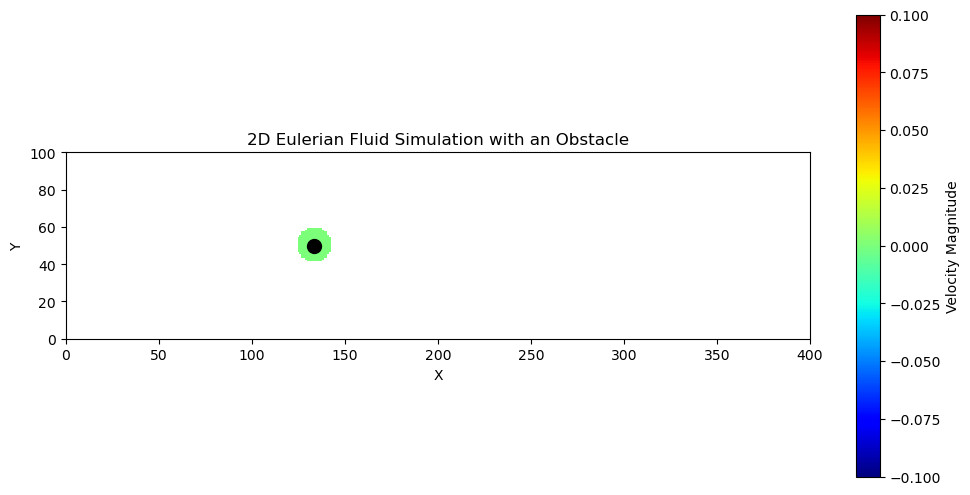

In [24]:
import numpy as np
import matplotlib.pyplot as plt

# Simulation parameters
nx = 400          # Width of the grid
ny = 100          # Height of the grid
niters = 10000    # Number of iterations
tau = 0.6         # Relaxation time
obstacle_radius = 10  # Radius of the obstacle

# Directions for the D2Q9 model
v = np.array([[1, 0], [0, 1], [-1, 0], [0, -1], 
              [1, 1], [-1, 1], [-1, -1], [1, -1], [0, 0]])

# Weights for D2Q9 model
w = np.array([1, 1, 1, 1, 1 / 9, 1 / 9, 1 / 9, 1 / 9, 4 / 9])

# Initialize the density and velocity fields
rho = np.ones((nx, ny))
u = np.zeros((nx, ny, 2))

# Function to create an obstacle
def create_obstacle(grid, radius, center):
    for x in range(grid.shape[0]):
        for y in range(grid.shape[1]):
            if (x - center[0]) ** 2 + (y - center[1]) ** 2 < radius ** 2:
                grid[x, y] = 0  # Set the obstacle area to 0
    return grid

# Create the obstacle
obstacle = np.ones((nx, ny))
obstacle = create_obstacle(obstacle, obstacle_radius, (int(nx / 3), int(ny / 2)))

# Main simulation loop
f1 = np.ones((nx, ny))  # Distribution functions for the nine velocities
f2 = np.ones((nx, ny))
f3 = np.ones((nx, ny))
f4 = np.ones((nx, ny))
f5 = np.ones((nx, ny))
f6 = np.ones((nx, ny))
f7 = np.ones((nx, ny))
f8 = np.ones((nx, ny))
f9 = np.ones((nx, ny))  # This will be our 'rest' particle

# Main simulation loop
for it in range(niters):
    # Collision step
    feq = np.zeros((nx, ny, 9))  # Equilibrium distribution function
    for k in range(9):
        cu = 3 * (u[:, :, 0] * v[k, 0] + u[:, :, 1] * v[k, 1])
        feq[:, :, k] = rho * w[k] * (1 + cu + 0.5 * cu ** 2 - 1.5 * (u[:, :, 0] ** 2 + u[:, :, 1] ** 2))

    # Streaming step
    f1 = np.roll(np.roll(feq[:, :, 0], 1, axis=0), 0, axis=1)
    f2 = np.roll(np.roll(feq[:, :, 1], 0, axis=0), 1, axis=1)
    f3 = np.roll(np.roll(feq[:, :, 2], -1, axis=0), 0, axis=1)
    f4 = np.roll(np.roll(feq[:, :, 3], 0, axis=0), -1, axis=1)
    f5 = np.roll(np.roll(feq[:, :, 4], 1, axis=0), 1, axis=1)
    f6 = np.roll(np.roll(feq[:, :, 5], -1, axis=0), 1, axis=1)
    f7 = np.roll(np.roll(feq[:, :, 6], -1, axis=0), -1, axis=1)
    f8 = np.roll(np.roll(feq[:, :, 7], 1, axis=0), -1, axis=1)
    f9 = feq[:, :, 8]  # The rest particle does not move

    # Combine the distribution functions into one array
    f = np.stack([f1, f2, f3, f4, f5, f6, f7, f8, f9], axis=2)

    # Set the obstacle points to zero (no fluid)
    for k in range(9):
        f[:, :, k][obstacle == 0] = 0

    # Calculate density and velocity
    rho = np.sum(f, axis=2)
    u[:, :, 0] = np.sum(f * v[:, 0], axis=2) / rho
    u[:, :, 1] = np.sum(f * v[:, 1], axis=2) / rho

    # Compute velocity at the obstacle to ensure it stays solid
    u[obstacle == 0] = 0

# Plotting the results
plt.figure(figsize=(12, 6))
plt.imshow(np.sqrt(u[:, :, 0]**2 + u[:, :, 1]**2).T, cmap='jet', origin='lower', extent=[0, nx, 0, ny])
plt.colorbar(label='Velocity Magnitude')
plt.title('2D Eulerian Fluid Simulation with an Obstacle')
plt.scatter(nx / 3, ny / 2, s=obstacle_radius * 10, color='black')  # Draw the obstacle
plt.xlabel('X')
plt.ylabel('Y')
plt.show()
